<a href="https://colab.research.google.com/github/dsmiros/Capstone-2/blob/main/architecture_image_cnn_notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten, Conv2D, MaxPooling2D, Input, \
                                    AveragePooling2D,GlobalAveragePooling2D
from tensorflow.keras.models import Sequential
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from keras.datasets import mnist
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing import image_dataset_from_directory

from keras.models import Model
from keras.layers.merge import concatenate

from tensorflow.keras.callbacks import TensorBoard, ModelCheckpoint

from datetime import datetime
from sklearn.metrics import confusion_matrix

import itertools
import io
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
def define_simple_model(nb_filters, kernel_size, input_shape, pool_size):
    model = Sequential() # model is a linear stack of layers (don't change)

    # note: the convolutional layers and dense layers require an activation function
    # see https://keras.io/activations/|
    # and https://en.wikipedia.org/wiki/Activation_function
    # options: 'linear', 'sigmoid', 'tanh', 'relu', 'softplus', 'softsign'

    model.add(Conv2D(nb_filters,(kernel_size[0], kernel_size[1]),
                        padding='valid',
                        input_shape=input_shape)) #first conv. layer  KEEP
    model.add(Activation('relu')) # Activation specification necessary for Conv2D and Dense layers

    model.add(Conv2D(nb_filters, (kernel_size[0], kernel_size[1]), padding='valid')) #2nd conv. layer KEEP
    model.add(Activation('relu'))

    model.add(MaxPooling2D(pool_size=pool_size)) # decreases size, helps prevent overfitting
    model.add(Dropout(0.5)) # zeros out some fraction of inputs, helps prevent overfitting
    
    model.add(Conv2D(nb_filters, (kernel_size[0], kernel_size[1]), padding='valid')) #2nd conv. layer KEEP
    model.add(Activation('relu'))

    model.add(MaxPooling2D(pool_size=pool_size)) # decreases size, helps prevent overfitting
    model.add(Dropout(0.5))

    model.add(Flatten()) # necessary to flatten before going into conventional dense layer  KEEP
    print('Model flattened out to ', model.output_shape)

    # now start a typical neural network    
    model.add(Dense(512)) # (only) 32 neurons in this layer, really?   KEEP
    model.add(Activation('relu'))
    
    model.add(Dropout(0.5))
    
    model.add(Dense(128)) # (only) 32 neurons in this layer, really?   KEEP
    model.add(Activation('relu'))

    model.add(Dropout(0.5))

    model.add(Dense(10)) # 10 final nodes (one for each class)  KEEP
    model.add(Activation('softmax')) # softmax at end to pick between classes 0-9 KEEP

    # many optimizers available, see https://keras.io/optimizers/#usage-of-optimizers
    # suggest you KEEP loss at 'categorical_crossentropy' for this multiclass problem,
    # and KEEP metrics at 'accuracy'
    # suggest limiting optimizers to one of these: 'adam', 'adadelta', 'sgd'
    model.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])
    return model

In [ ]:
def load_and_featurize_data(DataFrame):
    # the data, shuffled and split between train and test sets
    dataframe = DataFrame.copy()
    if 'Unnamed: 0' in dataframe.columns:
      dataframe.drop('Unnamed: 0', axis = 1, inplace = True)
    dataframe = dataframe.sample(frac=1).reset_index(drop=True)
    y = dataframe.pop('Style')
    y = np.array([0 if val == 0 else 1 if val == 14 else 2 if val == 15 else 3 if val == 20 else 4 for val in y])
    X = dataframe
    X_train, X_test, y_train, y_test = train_test_split(X,y)

    # reshape input into format Conv2D layer likes
    print(X_test)
    X_train = np.array(X_train).reshape(X_train.shape[0], img_rows, img_cols, 3)
    X_test = np.array(X_test).reshape(X_test.shape[0], img_rows, img_cols, 3)

#     # don't change conversion or normalization
#     X_train = X_train.astype('float32') # data was uint8 [0-255]
#     X_test = X_test.astype('float32')  # data was uint8 [0-255]
#     X_train /= 255 # normalizing (scaling from 0 to 1)
#     X_test /= 255  # normalizing (scaling from 0 to 1)

    print('X_train shape:', X_train.shape)
    print(X_train.shape[0], 'train samples')
    print(X_test.shape[0], 'test samples')
    print(y_train)
    print(y_test)

#     convert class vectors to binary class matrices (don't change)
    Y_train = to_categorical(y_train, nb_classes) # cool
    Y_test = to_categorical(y_test, nb_classes)
    
    print(Y_train)
    print(Y_test)

#     in Ipython you should compare Y_test to y_test
    return X_train, X_test, Y_train, Y_test

In [ ]:
def plot_to_image(figure):
    """
    Converts the matplotlib plot specified by 'figure' to a PNG image and
    returns it. The supplied figure is closed and inaccessible after this call.
    """
    
    buf = io.BytesIO()
    
    # Use plt.savefig to save the plot to a PNG in memory.
    plt.savefig(buf, format='png')
    
    # Closing the figure prevents it from being displayed directly inside
    # the notebook.
    plt.close(figure)
    buf.seek(0)
    
    # Use tf.image.decode_png to convert the PNG buffer
    # to a TF image. Make sure you use 4 channels.
    image = tf.image.decode_png(buf.getvalue(), channels=4)
    
    # Use tf.expand_dims to add the batch dimension
    image = tf.expand_dims(image, 0)
    
    return image

In [ ]:
def log_confusion_matrix(epoch, logs):
    
    # Use the model to predict the values from the test_images.
    test_pred_raw = model.predict(X_test)
    
    test_pred = np.argmax(test_pred_raw, axis=1)
    #print(test_pred, np.argmax(y_test, axis = 1)) 
    #test_pred = np.array(pd.get_dummies(test_pred)
    
    # Calculate the confusion matrix using sklearn.metrics
    cm = confusion_matrix(np.argmax(y_test, axis = 1), test_pred)
    
    figure = plot_confusion_matrix(cm, class_names=['Achaemenid', 'Georgian', 'Gothic', 'Postmodern', 'Queen_anne'])
    cm_image = plot_to_image(figure)
    
    # Log the confusion matrix as an image summary.
    with file_writer_cm.as_default():
        tf.summary.image("Confusion Matrix", cm_image, step=epoch)

In [ ]:
def plot_confusion_matrix(cm, class_names = ['Achaemenid', 'Deconstructivism', 'Gothic', 'Russian_Revival', 'Tudor_Revival']):
    """
    Returns a matplotlib figure containing the plotted confusion matrix.
    
    Args:
       cm (array, shape = [n, n]): a confusion matrix of integer classes
       class_names (array, shape = [n]): String names of the integer classes
    """
    
    figure = plt.figure(figsize=(8, 8))
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Blues)
    plt.title("Confusion matrix")
    plt.colorbar()
    tick_marks = np.arange(len(class_names))
    plt.xticks(tick_marks, class_names, rotation=45)
    plt.yticks(tick_marks, class_names)
    
    # Normalize the confusion matrix.
    cm = np.around(cm.astype('float') / cm.sum(axis=1)[:, np.newaxis], decimals=2)
    
    # Use white text if squares are dark; otherwise black.
    threshold = cm.max() / 2.
    
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        color = "white" if cm[i, j] > threshold else "black"
        plt.text(j, i, cm[i, j], horizontalalignment="center", color=color)
        
    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    return figure

In [ ]:
def image_plot_predict(rows, batch, model, cols=50, num_classes = 5):  
    """ 
    Plots images with thier predicted class and actual class  
    Used after model has been fit to see results of test data
    Parameters: 
    rows (int): number of rows for the images displayed
    batch (ImageDataGenerator): test batch of pictures that will be predicted in model
    model : the model training images have been trained on to be used to predict test images
    cols (int) : number of columns displayed ( set to batch size )
    Returns: 
    plot: Plot of images with their predicted class and their actual class
    """
    if num_classes == 10:
      types = ['Achaemenid', 'Art_Nouveau',
        'Baroque', 'Deconstructivism', 'Foursquare', 
        'Georgian', 'Gothic', 
        'Postmodern', 'Queen_anne',
        'Tudor']
    elif num_classes == 4:
      types = ['Achaemenid', 'Bar_Goth_Nouveau', 'Postmodern Urban', 'Suburbia']
    else:
      types = ['Achaemenid', 'Deconstructivism', 'Gothic', 'Russian Revival', 'Tudor Revival']
    fig, axs = plt.subplots(rows,cols,figsize=(cols * 4,rows * 4))
    for i in range(rows):
        images, labels = next(batch)
        predictions = model.predict(images)
        for j, pic in enumerate(images):
            title = 'Predicted:' + ' ' + types[list(predictions[j]).index(predictions[j].max())] + ' ' + '\n' + 'Actual:' + ' ' + types[list(labels[j]).index(1)] + '\n' + 'Confidence:' + str(predictions[j].max().round(2))
            if rows > 1:
                axs[i,j].imshow(pic)
                axs[i,j].set_title(title)
            else:
                axs[j].imshow(pic)
                axs[j].set_title(title)
    plt.tight_layout()

In [ ]:
logdir = 'logs/image/' + datetime.now().strftime("%Y%m%d-%H%M%S")

tensorboard_callback = TensorBoard(log_dir = logdir, histogram_freq=1)

#early_stop_callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5)

# file_writer_cm = tf.summary.create_file_writer(logdir +'/cm')

# cm_callback = keras.callbacks.LambdaCallback(on_epoch_end=log_confusion_matrix)

In [ ]:
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale = 1./255)
train_ten_generator = train_datagen.flow_from_directory('/content/drive/MyDrive/ten_styles/train',
                                                    target_size = (224,224), batch_size = 50, class_mode = 'categorical')
validation_ten_generator = test_datagen.flow_from_directory('/content/drive/MyDrive/ten_styles/validation',
                                                        target_size = (224,224), batch_size = 50, 
                                                         class_mode = 'categorical')

Found 3058 images belonging to 10 classes.
Found 654 images belonging to 10 classes.


In [ ]:
# Save the file name
import os
checkpoint_path_google = "drive/MyDrive/googlenet_architecture/cp_{epoch:04d}" # all the trained weights
checkpoint_dir_google = os.path.dirname(checkpoint_path_google)

# Create checkpoint
google_checkpoints = tf.keras.callbacks.ModelCheckpoint(
filepath = checkpoint_path_google, 
verbose = 1, 
save_weights_only = True,
save_best_only = True, # only save the best epoch
monitor = 'val_accuracy',
save_freq = 'epoch') # after epoch 

In [ ]:
from functools import partial

DefaultConv2D = partial(keras.layers.Conv2D, kernel_size=3, strides=1,
                        padding="SAME", use_bias=False)

class ResidualUnit(keras.layers.Layer):
    def __init__(self, filters, strides=1, activation="relu", **kwargs):
        super().__init__(**kwargs)
        self.activation = keras.activations.get(activation)
        self.main_layers = [
            DefaultConv2D(filters, strides=strides),
            keras.layers.BatchNormalization(),
            self.activation,
            DefaultConv2D(filters),
            keras.layers.BatchNormalization()]
        self.skip_layers = []
        if strides > 1:
            self.skip_layers = [
                DefaultConv2D(filters, kernel_size=1, strides=strides),
                keras.layers.BatchNormalization()]

    def call(self, inputs):
        Z = inputs
        for layer in self.main_layers:
            Z = layer(Z)
        skip_Z = inputs
        for layer in self.skip_layers:
            skip_Z = layer(skip_Z)
        return self.activation(Z + skip_Z)

In [ ]:
early_stop_callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=5)

In [ ]:
%load_ext tensorboard

In [ ]:
final_mat = confusion_matrix(np.argmax(y_test, axis = 1), np.argmax(model.predict(X_test), axis=1))

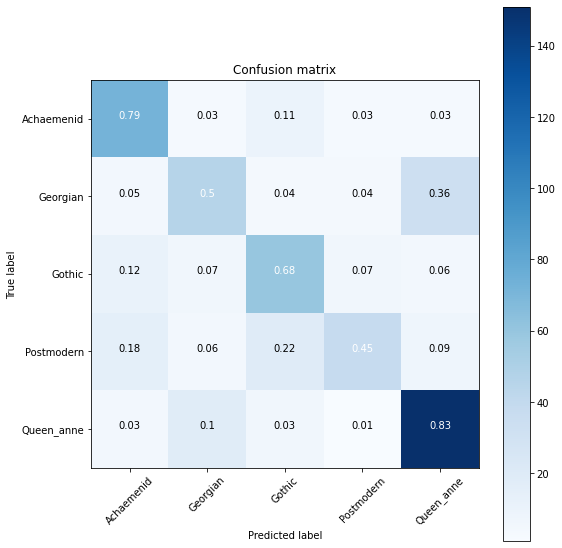

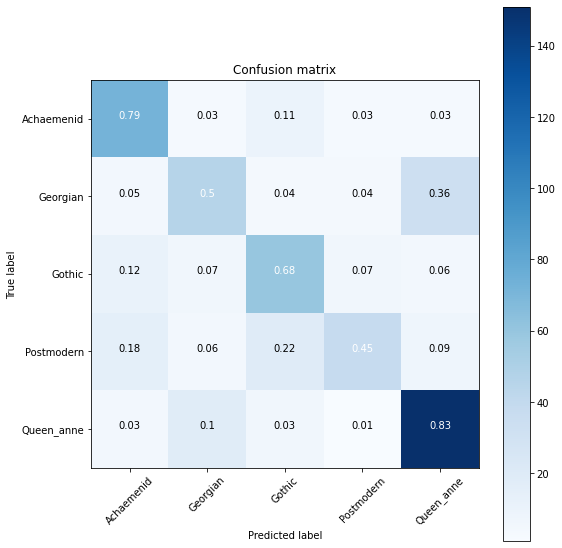

In [ ]:
plot_confusion_matrix(final_mat)

In [ ]:
%load_ext tensorboard

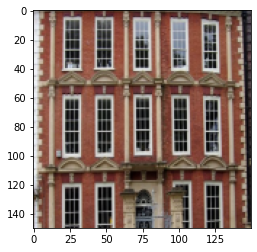

In [ ]:
plt.imshow(np.array(X_test[34]).reshape(150,150,3))

In [ ]:
#Achaemenid_color, Georgian_color, Gothic_color, Postmodern_color, Queen_anne_color
predictions[2][34]

array([4.2945928e-11, 6.1930856e-04, 1.0677678e-07, 2.9593696e-06,
       9.9937767e-01], dtype=float32)

In [ ]:
prediction = np.mean(predictions, axis = 0)
prediction[34]

array([3.7321830e-09, 3.4069635e-03, 1.9299482e-06, 8.9500272e-06,
       9.9658221e-01], dtype=float32)

In [ ]:
y_test[34]

array([0., 1., 0., 0., 0.], dtype=float32)

In [ ]:
guess = np.argmax(predictions[2], axis = 1)
correct = []
wrong = []
for idx, row in enumerate(y_test):
  if row[guess[idx]] == 1:
    correct.append(idx)
  else:
    wrong.append(idx)

wrong_guess = []
right_ans = []
for error in wrong:
  wrong_guess.append(np.argmax(predictions[2][error]))
  right_ans.append(np.argmax(y_test[error]))

wrong_right_guesses = np.column_stack((wrong_guess, right_ans))
C = dict()
for guess in wrong_right_guesses:
  if f'({guess[0]}, {guess[1]})' in C:
    C[f'({guess[0]}, {guess[1]})'] += 1
  else:
    C[f'({guess[0]}, {guess[1]})'] = 1
C

{'(0, 1)': 3,
 '(0, 2)': 8,
 '(0, 3)': 10,
 '(0, 4)': 3,
 '(1, 0)': 6,
 '(1, 2)': 5,
 '(1, 3)': 7,
 '(1, 4)': 22,
 '(2, 0)': 6,
 '(2, 1)': 3,
 '(2, 3)': 1,
 '(2, 4)': 4,
 '(3, 0)': 7,
 '(3, 1)': 1,
 '(3, 2)': 8,
 '(3, 4)': 4,
 '(4, 1)': 19,
 '(4, 2)': 4,
 '(4, 3)': 7}

In [ ]:
# Save the file name
import os
checkpoint_path_base = "drive/MyDrive/baseline_architecture/cp_{epoch:04d}" # all the trained weights
checkpoint_dir_base = os.path.dirname(checkpoint_path_base)

# Create checkpoint
checkpoints_base = tf.keras.callbacks.ModelCheckpoint(
filepath = checkpoint_path_base, 
verbose = 1, 
save_weights_only = True,
save_best_only = True, # only save the best epoch
monitor = 'val_accuracy',
save_freq = 'epoch') # after epoch 

In [ ]:
model = define_simple_model(32, (3,3), (224,224,3), (2,2))

    # during fit process watch train and test error simultaneously
model.fit(train_ten_generator, batch_size=50, epochs=2000, steps_per_epoch = 50, verbose=1, validation_data=validation_ten_generator, callbacks = [tensorboard_callback, early_stop_callback, checkpoints_base])


Model flattened out to  (None, 93312)
Epoch 1/2000
50/50 [==============================] - 46s 893ms/step - loss: 2.8205 - accuracy: 0.1314 - val_loss: 2.2960 - val_accuracy: 0.1651

Epoch 00001: val_accuracy did not improve from 0.16514
Epoch 2/2000
50/50 [==============================] - 40s 807ms/step - loss: 2.2501 - accuracy: 0.1692 - val_loss: 2.2510 - val_accuracy: 0.1697

Epoch 00002: val_accuracy improved from 0.16514 to 0.16972, saving model to drive/MyDrive/baseline_architecture/cp_0002
Epoch 3/2000
50/50 [==============================] - 42s 843ms/step - loss: 2.1947 - accuracy: 0.1851 - val_loss: 2.1592 - val_accuracy: 0.2263

Epoch 00003: val_accuracy improved from 0.16972 to 0.22630, saving model to drive/MyDrive/baseline_architecture/cp_0003
Epoch 4/2000
50/50 [==============================] - 42s 839ms/step - loss: 2.1413 - accuracy: 0.2044 - val_loss: 2.0965 - val_accuracy: 0.2523

Epoch 00004: val_accuracy improved from 0.22630 to 0.25229, saving model to drive/M

In [ ]:
)# Save the file name
import os
checkpoint_path_25 = "drive/MyDrive/architectural-styles-dataset/cp_{epoch:04d}" # all the trained weights
checkpoint_dir_25 = os.path.dirname(checkpoint_path_25)

# Create checkpoint
checkpoints_25 = tf.keras.callbacks.ModelCheckpoint(
filepath = checkpoint_path_25, 
verbose = 1, 
save_weights_only = True,
save_best_only = True, # only save the best epoch
monitor = 'val_accuracy',
save_freq = 'epoch') # after epoch 

In [ ]:
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale = 1./255)
train_generator = train_datagen.flow_from_directory('/content/drive/MyDrive/architectural-styles-dataset/train',
                                                    target_size = (224,224), batch_size = 32, class_mode = 'categorical')
validation_generator = test_datagen.flow_from_directory('/content/drive/MyDrive/architectural-styles-dataset/validation',
                                                        target_size = (224,224), batch_size = 32, 
                                                         class_mode = 'categorical')


model = keras.models.Sequential()
model.add(DefaultConv2D(64, kernel_size=7, strides=2,
                        input_shape=[224, 224, 3]))
model.add(keras.layers.BatchNormalization())
model.add(keras.layers.Activation("relu"))
model.add(keras.layers.MaxPool2D(pool_size=3, strides=2, padding="SAME"))
prev_filters = 64
for filters in [64] * 3 + [128] * 4 + [256] * 6 + [512] * 3:
    strides = 1 if filters == prev_filters else 2
    model.add(ResidualUnit(filters, strides=strides))
    prev_filters = filters
model.add(keras.layers.GlobalAvgPool2D())
model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(25, activation="softmax"))

model.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy', tf.keras.metrics.TopKCategoricalAccuracy(k=3)])


model.fit(train_generator, epochs = 2000, steps_per_epoch = 221, batch_size = 32, validation_data = validation_generator,
          verbose = 1, callbacks = [tensorboard_callback, early_stop_callback, checkpoints_25])

Found 7077 images belonging to 25 classes.
Found 1514 images belonging to 25 classes.
Epoch 1/2000
221/221 [==============================] - 2247s 10s/step - loss: 3.0717 - accuracy: 0.1314 - top_k_categorical_accuracy: 0.2991 - val_loss: 7.8960 - val_accuracy: 0.0535 - val_top_k_categorical_accuracy: 0.1341

Epoch 00001: val_accuracy improved from -inf to 0.05350, saving model to drive/MyDrive/architectural-styles-dataset/cp_0001
Epoch 2/2000
221/221 [==============================] - 82s 373ms/step - loss: 2.7905 - accuracy: 0.1703 - top_k_categorical_accuracy: 0.3861 - val_loss: 3.3353 - val_accuracy: 0.0931 - val_top_k_categorical_accuracy: 0.2312

Epoch 00002: val_accuracy improved from 0.05350 to 0.09313, saving model to drive/MyDrive/architectural-styles-dataset/cp_0002
Epoch 3/2000
221/221 [==============================] - 82s 371ms/step - loss: 2.6003 - accuracy: 0.2224 - top_k_categorical_accuracy: 0.4551 - val_loss: 4.5892 - val_accuracy: 0.1202 - val_top_k_categorical_acc

In [ ]:
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale = 1./255)
train_generator = train_datagen.flow_from_directory('/content/drive/MyDrive/architectural-styles-dataset/train',
                                                    target_size = (224,224), batch_size = 32, class_mode = 'categorical')
validation_generator = test_datagen.flow_from_directory('/content/drive/MyDrive/architectural-styles-dataset/validation',
                                                        target_size = (224,224), batch_size = 32, 
                                                         class_mode = 'categorical')


model = keras.models.Sequential()
model.add(DefaultConv2D(64, kernel_size=7, strides=2,
                        input_shape=[224, 224, 3]))
model.add(keras.layers.BatchNormalization())
model.add(keras.layers.Activation("relu"))
model.add(keras.layers.MaxPool2D(pool_size=3, strides=2, padding="SAME"))
prev_filters = 64
for filters in [64] * 3 + [128] * 4 + [256] * 6 + [512] * 3:
    strides = 1 if filters == prev_filters else 2
    model.add(ResidualUnit(filters, strides=strides))
    prev_filters = filters
model.add(keras.layers.GlobalAvgPool2D())
model.add(keras.layers.Flatten())
model.add(keras.layers.Dense(25, activation="softmax"))

model.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy'])


Found 7077 images belonging to 25 classes.
Found 1514 images belonging to 25 classes.
Instructions for updating:
Restoring a name-based tf.train.Saver checkpoint using the object-based restore API. This mode uses global names to match variables, and so is somewhat fragile. It also adds new restore ops to the graph each time it is called when graph building. Prefer re-encoding training checkpoints in the object-based format: run save() on the object-based saver (the same one this message is coming from) and use that checkpoint in the future.


AssertionError: ignored

In [ ]:
model.load_weights('/content/drive/MyDrive/architectural-styles-dataset/cp_0030') 

In [ ]:
predictions = model.evaluate(validation_generator)

48/48 [==============================] - 417s 9s/step - loss: 4.9763 - accuracy: 0.3435


In [ ]:
style_dict = {}
style_nums = np.arange(25)
style_names = ['Achaemenid', 'Ancient_egyptian', 'Art_deco', 'Art_Nouveau',
        'Baroque', 'Bauhaus', 'Beaux_arts', 'Byzantine', 'Chicago_school', 'Craftsman', 
        'Colonial', 'Deconstructivism', 'Edwardian', 'Foursquare', 
        'Georgian', 'Gothic', 'Greek_revival', 'International', 'Novelty', 'Palladian', 
        'Postmodern', 'Queen_anne', 'Romanesque',
        'Russian_revival', 'Tudor']

for num, name in zip(style_nums, style_names):
  style_dict[num] = name

In [ ]:
predictions[99]

array([2.6796741e-02, 8.1449769e-02, 8.0739081e-01, 1.0669458e-02,
       3.4080807e-03, 7.1789378e-07, 3.5839435e-04, 1.6464519e-04,
       6.3615288e-03, 8.3856210e-03, 1.2003086e-08, 7.1095037e-09,
       8.1186714e-03, 1.4767893e-04, 5.4481314e-03, 4.4292546e-04,
       4.0653340e-08, 2.1860132e-04, 3.3493191e-06, 2.1305544e-02,
       1.7534807e-02, 6.5821581e-08, 1.2886947e-03, 4.7422748e-04,
       3.1520631e-05], dtype=float32)

In [ ]:
for i,n in enumerate(np.argsort(predictions[1])[:-25:-1]):
  print(i, style_dict[n])


0 Tudor
1 Bauhaus
2 Craftsman
3 International
4 Art_Nouveau
5 Colonial
6 Chicago_school
7 Gothic
8 Foursquare
9 Deconstructivism
10 Edwardian
11 Russian_revival
12 Ancient_egyptian
13 Novelty
14 Art_deco
15 Queen_anne
16 Georgian
17 Achaemenid
18 Romanesque
19 Postmodern
20 Beaux_arts
21 Byzantine
22 Greek_revival
23 Palladian


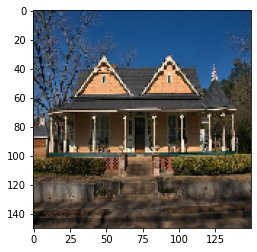

In [ ]:
image = validation_generator[0]
plt.imshow(image[0][1])

In [ ]:
# Save the file name
import os
checkpoint_path = "drive/MyDrive/ten_styles/cp_{epoch:04d}" # all the trained weights
checkpoint_dir = os.path.dirname(checkpoint_path)

# Create checkpoint
checkpoints_10 = tf.keras.callbacks.ModelCheckpoint(
filepath = checkpoint_path, 
verbose = 1, 
save_weights_only = True,
save_best_only = True, # only save the best epoch
monitor = 'val_accuracy',
save_freq = 'epoch') # after epoch 

In [ ]:
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale = 1./255)
train_ten_generator = train_datagen.flow_from_directory('/content/drive/MyDrive/ten_styles/train',
                                                    target_size = (224,224), batch_size = 50, class_mode = 'categorical')
validation_ten_generator = test_datagen.flow_from_directory('/content/drive/MyDrive/ten_styles/validation',
                                                        target_size = (224,224), batch_size = 50, 
                                                         class_mode = 'categorical')

Found 3058 images belonging to 10 classes.
Found 654 images belonging to 10 classes.


In [ ]:
model_ten = keras.models.Sequential()
model_ten.add(DefaultConv2D(64, kernel_size=7, strides=2,
                        input_shape=[224, 224, 3]))
model_ten.add(keras.layers.BatchNormalization())
model_ten.add(keras.layers.Activation("relu"))
model_ten.add(keras.layers.MaxPool2D(pool_size=3, strides=2, padding="SAME"))
prev_filters = 64
for filters in [64] * 3 + [128] * 4 + [256] * 6 + [512] * 3:
    strides = 1 if filters == prev_filters else 2
    model_ten.add(ResidualUnit(filters, strides=strides))
    prev_filters = filters
model_ten.add(keras.layers.GlobalAvgPool2D())
model_ten.add(keras.layers.Flatten())
model_ten.add(keras.layers.Dense(10, activation="softmax"))

model_ten.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy', 'Recall', 'Precision'])


model_ten.load_weights('/content/drive/MyDrive/ten_styles/cp_0034')

In [ ]:
model_ten.fit(train_ten_generator, epochs = 2000, steps_per_epoch = 60, batch_size = 50, validation_data = validation_ten_generator,
          verbose = 1, callbacks = [tensorboard_callback, early_stop_callback, checkpoints_10])

In [ ]:
model_ten.evaluate(validation_ten_generator)

14/14 [==============================] - 158s 12s/step - loss: 2.5186 - accuracy: 0.5489 - recall: 0.5352 - precision: 0.5609


[2.5185840129852295,
 0.5489296913146973,
 0.5351681709289551,
 0.5608974099159241]

In [ ]:
ten_predictions = model_ten.predict(validation_ten_generator)

In [ ]:
np.argmax(ten_predictions[:50], axis = 1), np.argmax(validation_ten_generator[0][1], axis = 1)

(array([5, 4, 8, 8, 8, 0, 7, 8, 2, 4, 6, 1, 1, 4, 0, 2, 5, 6, 5, 1, 7, 1,
        8, 7, 6, 7, 4, 3, 0, 3, 7, 7, 0, 7, 5, 2, 4, 0, 7, 7, 5, 1, 9, 8,
        5, 1, 9, 8, 0, 9]),
 array([6, 6, 4, 2, 1, 5, 3, 8, 1, 4, 4, 9, 7, 1, 1, 8, 8, 8, 6, 6, 1, 8,
        7, 2, 5, 1, 5, 7, 5, 1, 4, 8, 2, 2, 7, 1, 9, 4, 8, 0, 0, 4, 3, 6,
        6, 5, 2, 0, 0, 3]))

In [ ]:
y_ten = []
for i in range(14):
  y_ten.append(np.argmax(validation_ten_generator[i][1], axis = 1))

KeyboardInterrupt: ignored

In [ ]:
style_ten_dict = {}
style_ten_nums = np.arange(10)
style_ten_names = ['Achaemenid', 'Art_Nouveau',
        'Baroque', 'Deconstructivism', 'Foursquare', 
        'Georgian', 'Gothic', 
        'Postmodern', 'Queen_anne',
        'Tudor']

for num, name in zip(style_ten_nums, style_ten_names):
  style_ten_dict[num] = name

In [ ]:
# for i,n in enumerate(np.argmax(ten_predictions[0])):
#   print(i, style_ten_dict[n])
style_ten_dict[np.argmax(ten_predictions[9])], ten_predictions[9]

('Foursquare',
 array([7.9994151e-14, 7.9904618e-11, 2.4752104e-12, 9.2480732e-13,
        6.1698490e-01, 3.5615427e-05, 4.7057925e-13, 3.9768206e-12,
        3.8297194e-01, 7.5501434e-06], dtype=float32))

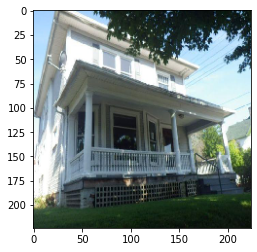

In [ ]:
image = validation_ten_generator[0]
plt.imshow(image[0][9])

In [ ]:
style_ten_dict[np.argmax(image[1][4])]

'Gothic'

In [ ]:
# Save the file name
import os
checkpoint_5_path = "drive/MyDrive/five_styles/cp_{epoch:04d}" # all the trained weights
checkpoint_5_dir = os.path.dirname(checkpoint_5_path)

# Create checkpoint
checkpoints_5 = tf.keras.callbacks.ModelCheckpoint(
filepath = checkpoint_5_path, 
verbose = 1, 
save_weights_only = True,
save_best_only = True, # only save the best epoch
monitor = 'val_accuracy',
save_freq = 'epoch') # after epoch 

In [ ]:
# Save the file name
import os
checkpoint_5_path_alt = "drive/MyDrive/five_styles_alt/cp_{epoch:04d}" # all the trained weights
checkpoint_5_dir_alt = os.path.dirname(checkpoint_5_path_alt)

# Create checkpoint
checkpoints_5_alt = tf.keras.callbacks.ModelCheckpoint(
filepath = checkpoint_5_path_alt, 
verbose = 1, 
save_weights_only = True,
save_best_only = True, # only save the best epoch
monitor = 'val_accuracy',
save_freq = 'epoch') # after epoch 

In [ ]:
train_datagen_alter = ImageDataGenerator(rescale=1./255, shear_range=0.2,
        zoom_range=0.2,
        horizontal_flip=True)
test_datagen = ImageDataGenerator(rescale = 1./255)
train_five_generator_alter = train_datagen_alter.flow_from_directory('/content/drive/MyDrive/five_styles/train',
                                                    target_size = (224,224), batch_size = 16, class_mode = 'categorical')
validation_five_generator = test_datagen.flow_from_directory('/content/drive/MyDrive/five_styles/validation',
                                                        target_size = (224,224), batch_size = 16, 
                                                         class_mode = 'categorical')

Found 1305 images belonging to 5 classes.
Found 280 images belonging to 5 classes.


In [ ]:
model_five = keras.models.Sequential()
model_five.add(DefaultConv2D(64, kernel_size=7, strides=2,
                        input_shape=[224, 224, 3]))
model_five.add(keras.layers.BatchNormalization())
model_five.add(keras.layers.Activation("relu"))
model_five.add(keras.layers.MaxPool2D(pool_size=3, strides=2, padding="SAME"))
prev_filters = 64
for filters in [64] * 3 + [128] * 4 + [256] * 6 + [512] * 3:
    strides = 1 if filters == prev_filters else 2
    model_five.add(ResidualUnit(filters, strides=strides))
    prev_filters = filters
model_five.add(keras.layers.GlobalAvgPool2D())
model_five.add(keras.layers.Flatten())
model_five.add(keras.layers.Dense(5, activation="softmax"))

model_five.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy', tf.keras.metrics.TopKCategoricalAccuracy(k=2)])

model_five.load_weights('/content/drive/MyDrive/five_styles/cp_0055')

In [ ]:
model_five.fit(train_five_generator_alter, epochs = 2000, steps_per_epoch = 50, batch_size = 16, validation_data = validation_five_generator,
          verbose = 1, callbacks = [tensorboard_callback, early_stop_callback, checkpoints_5_alt])

Epoch 1/2000
50/50 [==============================] - 391s 8s/step - loss: 0.6518 - accuracy: 0.8008 - top_k_categorical_accuracy: 0.9319 - val_loss: 2.3019 - val_accuracy: 0.5714 - val_top_k_categorical_accuracy: 0.6857

Epoch 00001: val_accuracy improved from -inf to 0.57143, saving model to drive/MyDrive/five_styles_alt/cp_0001
Epoch 2/2000
50/50 [==============================] - 132s 3s/step - loss: 0.6290 - accuracy: 0.7831 - top_k_categorical_accuracy: 0.9180 - val_loss: 3.1512 - val_accuracy: 0.5000 - val_top_k_categorical_accuracy: 0.6536

Epoch 00002: val_accuracy did not improve from 0.57143
Epoch 3/2000
50/50 [==============================] - 63s 1s/step - loss: 0.3759 - accuracy: 0.8725 - top_k_categorical_accuracy: 0.9588 - val_loss: 4.0281 - val_accuracy: 0.4393 - val_top_k_categorical_accuracy: 0.6607

Epoch 00003: val_accuracy did not improve from 0.57143
Epoch 4/2000
50/50 [==============================] - 36s 718ms/step - loss: 0.3004 - accuracy: 0.8903 - top_k_cat

In [ ]:
model_five.summary()

Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_252 (Conv2D)          (None, 112, 112, 64)      9408      
_________________________________________________________________
batch_normalization_252 (Bat (None, 112, 112, 64)      256       
_________________________________________________________________
activation_7 (Activation)    (None, 112, 112, 64)      0         
_________________________________________________________________
max_pooling2d_7 (MaxPooling2 (None, 56, 56, 64)        0         
_________________________________________________________________
residual_unit_112 (ResidualU (None, 56, 56, 64)        74240     
_________________________________________________________________
residual_unit_113 (ResidualU (None, 56, 56, 64)        74240     
_________________________________________________________________
residual_unit_114 (ResidualU (None, 56, 56, 64)       

In [ ]:
# Save the file name
import os
checkpoint_4_path = "drive/MyDrive/four_style_groups/cp_{epoch:04d}" # all the trained weights
checkpoint_4_dir = os.path.dirname(checkpoint_4_path)

# Create checkpoint
checkpoints_4 = tf.keras.callbacks.ModelCheckpoint(
filepath = checkpoint_4_path, 
verbose = 1, 
save_weights_only = True,
save_best_only = True, # only save the best epoch
monitor = 'val_accuracy',
save_freq = 'epoch') # after epoch 

In [ ]:
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale = 1./255)
train_four_generator = train_datagen.flow_from_directory('/content/drive/MyDrive/four_style_groups/train',
                                                    target_size = (224,224), batch_size = 30, class_mode = 'categorical')
validation_four_generator = test_datagen.flow_from_directory('/content/drive/MyDrive/four_style_groups/validation',
                                                        target_size = (224,224), batch_size = 30, 
                                                         class_mode = 'categorical')


model_four = keras.models.Sequential()
model_four.add(DefaultConv2D(64, kernel_size=7, strides=2,
                        input_shape=[224, 224, 3]))
model_four.add(keras.layers.BatchNormalization())
model_four.add(keras.layers.Activation("relu"))
model_four.add(keras.layers.MaxPool2D(pool_size=3, strides=2, padding="SAME"))
prev_filters = 64
for filters in [64] * 3 + [128] * 4 + [256] * 6 + [512] * 3:
    strides = 1 if filters == prev_filters else 2
    model_four.add(ResidualUnit(filters, strides=strides))
    prev_filters = filters
model_four.add(keras.layers.GlobalAvgPool2D())
model_four.add(keras.layers.Flatten())
model_four.add(keras.layers.Dense(4, activation="softmax"))

model_four.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy', tf.keras.metrics.TopKCategoricalAccuracy(k=2)])

model_four.fit(train_four_generator, epochs = 2000, steps_per_epoch = 100, batch_size = 30, validation_data = validation_four_generator,
          verbose = 1, callbacks = [tensorboard_callback, early_stop_callback, checkpoints_4])

Found 3058 images belonging to 4 classes.
Found 654 images belonging to 4 classes.
Epoch 1/2000
100/100 [==============================] - 1106s 11s/step - loss: 1.2695 - accuracy: 0.5120 - top_k_categorical_accuracy: 0.7979 - val_loss: 66.8410 - val_accuracy: 0.1498 - val_top_k_categorical_accuracy: 0.4725

Epoch 00001: val_accuracy improved from -inf to 0.14985, saving model to drive/MyDrive/four_style_groups/cp_0001
Epoch 2/2000
100/100 [==============================] - 50s 502ms/step - loss: 0.9148 - accuracy: 0.6124 - top_k_categorical_accuracy: 0.8619 - val_loss: 4.4455 - val_accuracy: 0.1514 - val_top_k_categorical_accuracy: 0.2385

Epoch 00002: val_accuracy improved from 0.14985 to 0.15138, saving model to drive/MyDrive/four_style_groups/cp_0002
Epoch 3/2000
100/100 [==============================] - 41s 410ms/step - loss: 0.8397 - accuracy: 0.6498 - top_k_categorical_accuracy: 0.8809 - val_loss: 4.1458 - val_accuracy: 0.3012 - val_top_k_categorical_accuracy: 0.4572

Epoch 000

In [ ]:
%tensorboard  --logdir ./logs

Reusing TensorBoard on port 6006 (pid 2681), started 3:03:47 ago. (Use '!kill 2681' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
model_four = keras.models.Sequential()
model_four.add(DefaultConv2D(64, kernel_size=7, strides=2,
                        input_shape=[224, 224, 3]))
model_four.add(keras.layers.BatchNormalization())
model_four.add(keras.layers.Activation("relu"))
model_four.add(keras.layers.MaxPool2D(pool_size=3, strides=2, padding="SAME"))
prev_filters = 64
for filters in [64] * 3 + [128] * 4 + [256] * 6 + [512] * 3:
    strides = 1 if filters == prev_filters else 2
    model_four.add(ResidualUnit(filters, strides=strides))
    prev_filters = filters
model_four.add(keras.layers.GlobalAvgPool2D())
model_four.add(keras.layers.Flatten())
model_four.add(keras.layers.Dense(4, activation="softmax"))

model_four.compile(loss='categorical_crossentropy',
                optimizer='adam',
                metrics=['accuracy', tf.keras.metrics.TopKCategoricalAccuracy(k=2)])

model_four.load_weights('/content/drive/MyDrive/four_style_groups/cp_0038')

Found 656 images belonging to 4 classes.


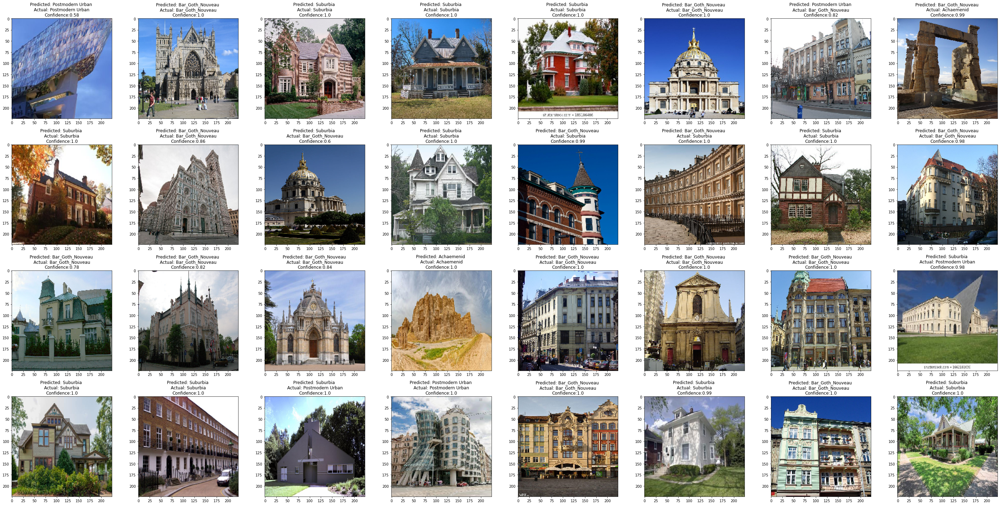

In [ ]:
test_datagen = ImageDataGenerator(rescale = 1./255)


holdout_four_generator = test_datagen.flow_from_directory('/content/drive/MyDrive/four_style_groups/holdout/',
                                                         target_size = (224,224), batch_size = 6, 
                                                         class_mode = 'categorical')

image_plot_predict(6, holdout_four_generator, model_four, cols = 6, num_classes = 4)

Found 656 images belonging to 10 classes.


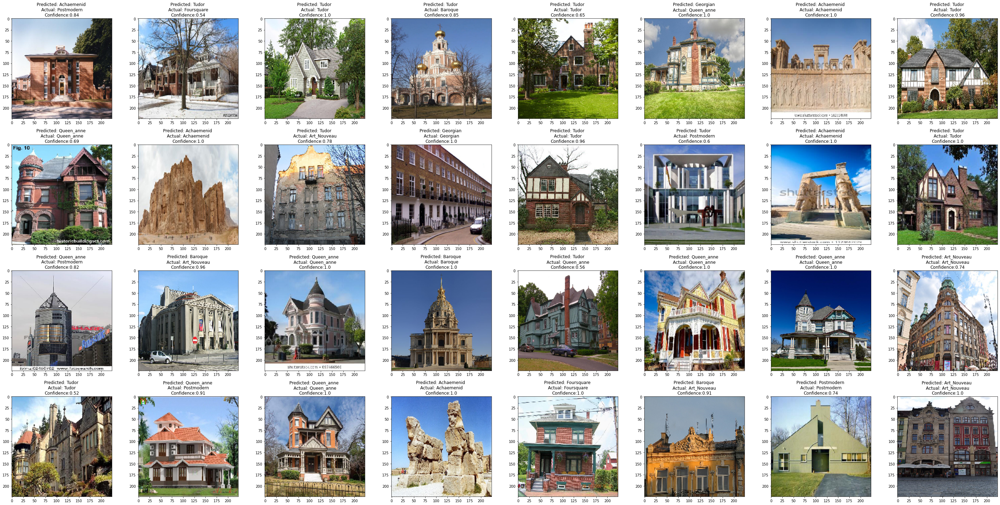

In [ ]:
test_datagen = ImageDataGenerator(rescale = 1./255)


holdout_ten_generator = test_datagen.flow_from_directory('/content/drive/MyDrive/ten_styles/holdout/',
                                                         target_size = (224,224), batch_size = 16, 
                                                         class_mode = 'categorical')

image_plot_predict(10, holdout_ten_generator, model_ten, cols = 16, num_classes = 10)

Found 279 images belonging to 5 classes.


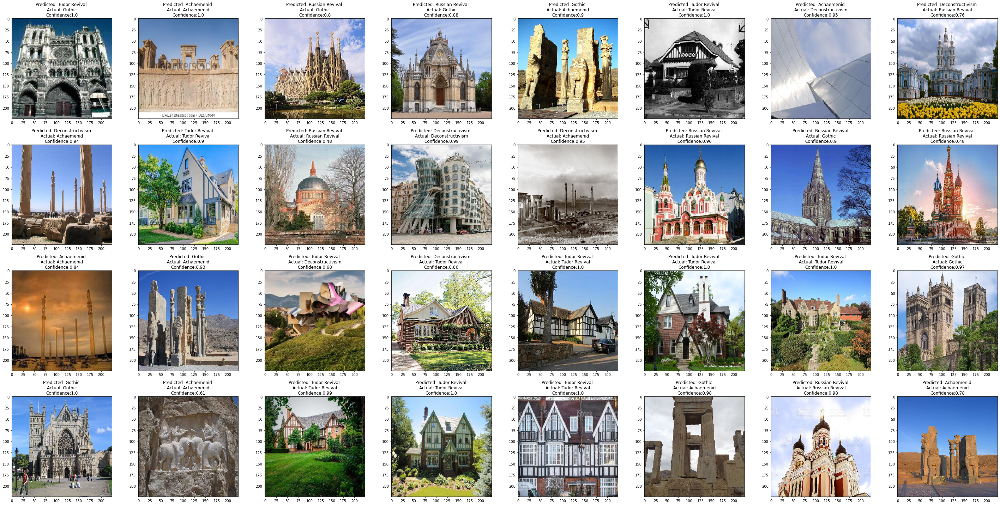

In [ ]:
test_datagen = ImageDataGenerator(rescale = 1./255)


holdout_five_generator = test_datagen.flow_from_directory('/content/drive/MyDrive/five_styles/holdout/',
                                                         target_size = (224,224), batch_size = 16, 
                                                         class_mode = 'categorical')

image_plot_predict(10, holdout_five_generator, model_five, cols = 16)

In [ ]:
y_four_actual = [(np.argmax(holdout_four_generator[i][1], axis = 1)) for i in range(656//16)]
empty = []
y_four_list = [[empty.append(y_four_actual[i][j]) for j in range(len(y_four_actual[i]))] for i in range(len(y_four_actual))]
y_four_list = empty

In [ ]:
final_mat_four = confusion_matrix(y_four_list, np.argmax(model_four.predict(holdout_four_generator), axis=1))

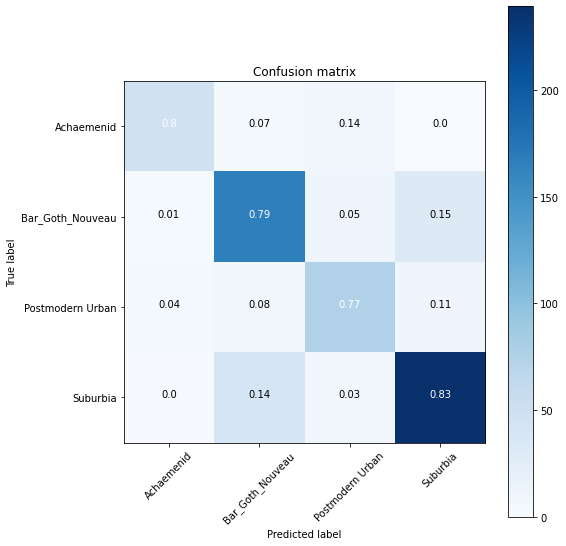

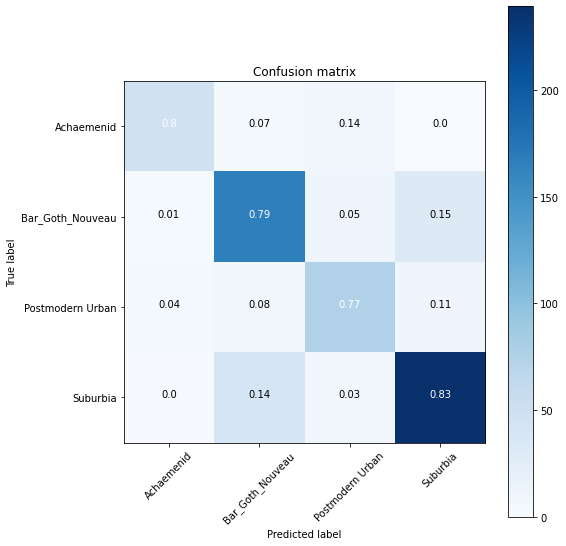

In [ ]:
plot_confusion_matrix(final_mat_four, class_names = ['Achaemenid','Bar_Goth_Nouveau','Postmodern Urban','Suburbia'])

In [ ]:
final_mat = confusion_matrix(y_five_list, np.argmax(model_five.predict(holdout_five_generator), axis=1))

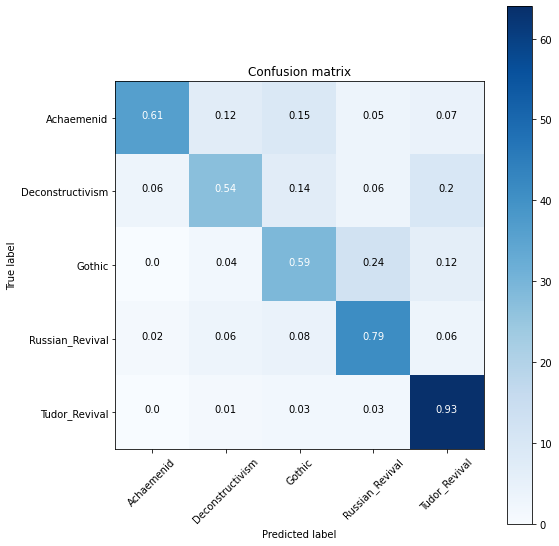

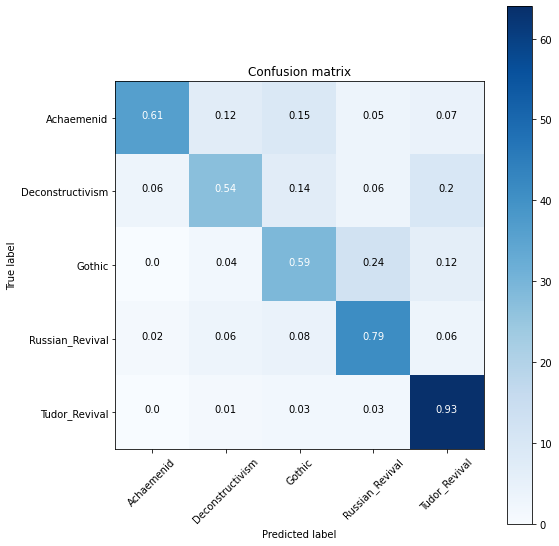

In [ ]:
plot_confusion_matrix(final_mat)

In [ ]:
holdout_five_generator.classes

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
       3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4], dtype=int32)

In [ ]:
np.argmax(holdout_five_generator[0][1], axis = 1)

array([3, 4, 0, 1, 4, 4, 4, 0, 1, 1, 2, 0, 1, 2, 4, 2])

In [ ]:
y_five_actual = [(np.argmax(holdout_five_generator[i][1], axis = 1)) for i in range(279//16+1)]
empty = []
y_five_list = [[empty.append(y_five_actual[i][j]) for j in range(len(y_five_actual[i]))] for i in range(len(y_five_actual))]
y_five_list = empty

In [ ]:
y_ten_actual = [(np.argmax(holdout_ten_generator[i][1], axis = 1)) for i in range(654//16+1)]
empty = []
y_ten_list = [[empty.append(y_ten_actual[i][j]) for j in range(len(y_ten_actual[i]))] for i in range(len(y_ten_actual))]
y_ten_list = empty

In [ ]:
final_mat_ten = confusion_matrix(y_ten_list, np.argmax(model_ten.predict(holdout_ten_generator), axis=1))

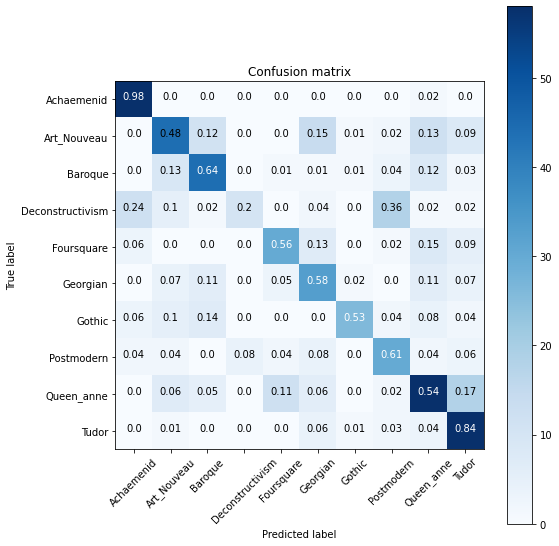

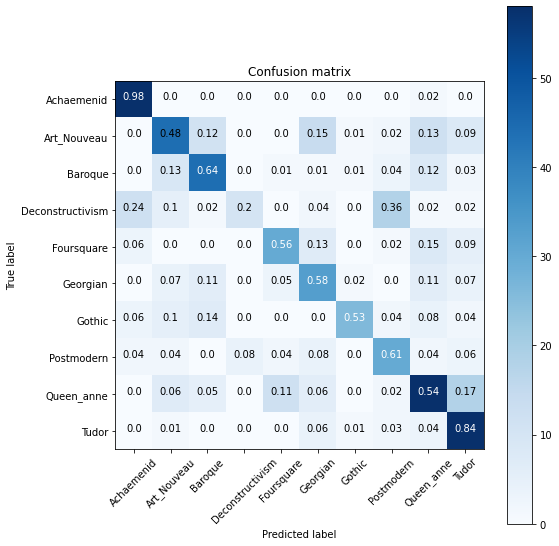

In [ ]:
plot_confusion_matrix(final_mat_ten, class_names = ['Achaemenid', 'Art_Nouveau',
        'Baroque', 'Deconstructivism', 'Foursquare', 
        'Georgian', 'Gothic', 
        'Postmodern', 'Queen_anne',
        'Tudor'])

In [ ]:
from collections import Counter
Counter(y_five_list)

In [ ]:
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.dummy import DummyClassifier

In [ ]:
y = five_color_styles.pop('Style')
X = five_color_styles

X_train, X_test, y_train, y_test = train_test_split(X,y)

In [ ]:
forest = RandomForestClassifier()
forest.fit(X_train,y_train)
forest.score(X_test, y_test)

0.5847299813780261

In [ ]:
dummy_class = DummyClassifier()
dummy_class.fit(X_train, y_train)
dummy_class.score(X_test, y_test)

/usr/local/lib/python3.7/dist-packages/sklearn/dummy.py:132: FutureWarning: The default value of strategy will change from stratified to prior in 0.24.
  "stratified to prior in 0.24.", FutureWarning)


0.21601489757914338

In [ ]:
forest_predictions = forest.predict(X_test)
confused_forest = confusion_matrix(y_test, forest_predictions)
confused_forest

array([[ 77,   7,   4,   3,  14],
       [  8,  28,   4,   1,  47],
       [  8,   3,  27,   6,  29],
       [  3,   1,  12,  33,  31],
       [ 14,  12,   9,   7, 149]])